# Test WGAN
Adapted from https://colab.research.google.com/github/timsainb/tensorflow2-generative-models/blob/master/3.0-WGAN-GP-fashion-mnist.ipynb

4/23/2020



In [1]:
# Make sure we have tqdm
# import sys
# !conda install --yes --prefix {sys.prefix} tqdm


In [2]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split

from tqdm.autonotebook import tqdm
from IPython import display
%matplotlib inline

from DataWGAN import DataWGAN
from DataLoader import DataLoader

In [3]:
print(tf.__version__)


2.0.0


In [4]:
def show_distribution(X, y, title=''):
    """
    Show strip plots for 1D data of multiple classes to allow
    comparison of distributions.
    """
    if len(X.shape) > 1 and not(len(X.shape) == 2 and X.shape[1]==1):
        print('** Just 1D data allowed')
        return -1
    
    X = np.reshape(X, (-1, 1))
    y = np.reshape(y, (-1, 1))    
    D = np.hstack((X, y))

    classes = np.unique(y)
    C = len(classes)
        
    plt.figure(figsize=(10, 1))
    fmt = ['bo', 'rv', 'gs', 'm.']
    
    for i, c in enumerate(classes):
        mask = D[:, 1] == c
        D_c = D[mask, 0]
        plt.plot( D_c, (C-i-1)*np.ones(D_c.shape[0]), fmt[i], alpha=0.2, label='class ' + str(int(c)))
        plt.plot([-0.02, 1.02], [i, i], 'k-', alpha=0.3)

    plt.legend(loc='center right')
    plt.ylim(-1, C)
    plt.xlim(-0.1, 1.22)
    plt.yticks(np.arange(C), classes)
    plt.axis('off')
    plt.title(title)
    plt.show()
    

In [6]:
data = DataLoader("adult.data")
data.df.head()


,age,workclass,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,label
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [7]:
numeric_data, labels, protected = data.get_numeric_data()

numeric_data = numeric_data.astype('float32')
labels = labels.astype('float32')
protected = protected.astype('float32')

print('Loaded data with shape', numeric_data.shape)

data_train, data_test, target_train, target_test = train_test_split(numeric_data, labels, test_size=0.2, random_state=42)

TRAIN_BUF=data_train.shape[0]
BATCH_SIZE=128
TEST_BUF=data_test.shape[0]
DIMS = data_train.shape[1:]
N_TRAIN_BATCHES = TRAIN_BUF // BATCH_SIZE
N_TEST_BATCHES = TEST_BUF // BATCH_SIZE
N_Z = 64



Loaded data with shape (32561, 90)


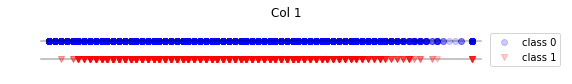

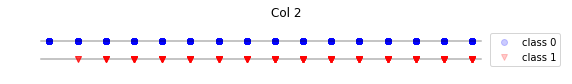

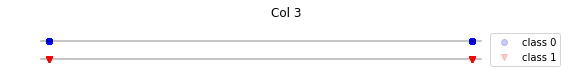

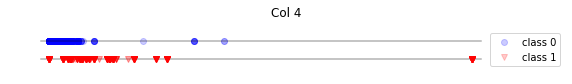

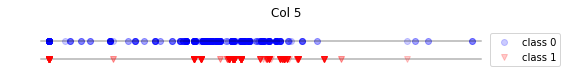

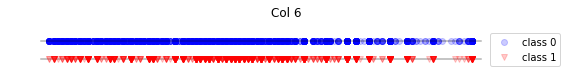

In [8]:
# Show distribution of values for a few columns of data
for i in range(6):
    show_distribution(numeric_data[:, i], labels, title='Col ' + str(i+1))


In [9]:
# exampled data for plotting results
def show_examples(model, nex=6):
    samples = model.generate(tf.random.normal(shape=(BATCH_SIZE, N_Z)))

    # Show distribution of values for a few columns of data
    for i in range(nex):
        # Don't have labels
        x = samples[:, i]
        y = np.zeros_like(x)
        show_distribution(x, y, title='Col ' + str(i+1))


In [10]:
# a pandas dataframe to save the loss information to
losses = pd.DataFrame(columns = ['disc_loss', 'gen_loss'])


In [11]:
model = DataWGAN(DIMS, N_Z)


Epoch: 199 | disc_loss: -0.3441412150859833 | gen_loss: 0.5221619009971619


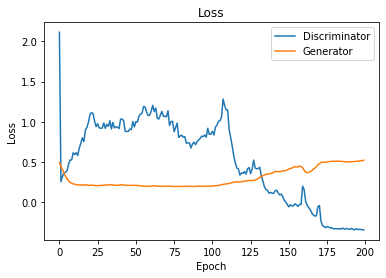

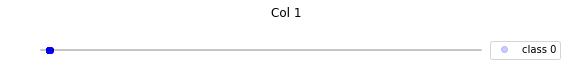

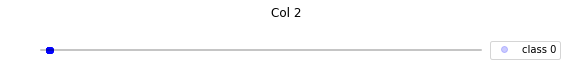

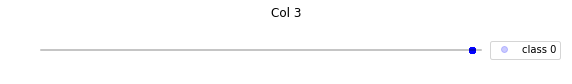

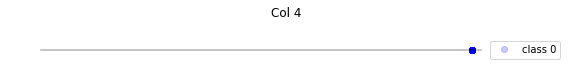

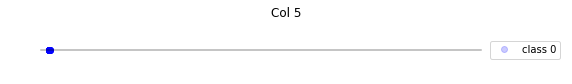

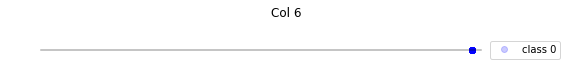

In [12]:
n_epochs = 200
for epoch in range(n_epochs):
    # train
    loss = []
    train_idx = np.random.permutation(TRAIN_BUF)
    for batch in range(N_TRAIN_BATCHES):
        curr_idx = train_idx[batch*BATCH_SIZE:(batch + 1)*BATCH_SIZE]
        train_x = data_train[curr_idx]
        train_y = target_train[curr_idx]
        model.train(train_x)
        loss.append(model.compute_loss(train_x))
        # print('\n**** {:03d}/{:03d}: {:03d}/{:03d}'.format(epoch+1, N_TRAIN_BATCHES, batch+1, N_TRAIN_BATCHES))

    losses.loc[len(losses)] = np.mean(loss, axis=0)

    # plot results
    display.clear_output()
    print(
        "Epoch: {} | disc_loss: {} | gen_loss: {}".format(
            epoch, losses.disc_loss.values[-1], losses.gen_loss.values[-1]
        )
    )
    plt.figure()
    plt.plot(losses.disc_loss, label='Discriminator')
    plt.plot(losses.gen_loss, label='Generator')
    plt.legend()
    plt.title('Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.show()

    show_examples(model)